# Dependency Installations

In [4]:
pip install numpy matplotlib scipy tensorflow

/opt/conda/lib/python3.10/pty.py:89: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  pid, fd = os.forkpty()


   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.7/1.7 MB 18.6 MB/s eta 0:00:00a 0:00:01
  Attempting uninstall: keras
    Found existing installation: keras 3.3.3
    Uninstalling keras-3.3.3:
      Successfully uninstalled keras-3.3.3
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
tensorflow-decision-forests 1.8.1 requires wurlitzer, which is not installed.
Note: you may need to restart the kernel to use updated packages.


In [5]:
pip install h5py

Note: you may need to restart the kernel to use updated packages.


In [9]:
!pip install --upgrade pip setuptools

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.8/1.8 MB 19.2 MB/s eta 0:00:00a 0:00:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 930.8/930.8 kB 43.9 MB/s eta 0:00:00
  Attempting uninstall: setuptools
    Found existing installation: setuptools 69.0.3
    Uninstalling setuptools-69.0.3:
      Successfully uninstalled setuptools-69.0.3
  Attempting uninstall: pip
    Found existing installation: pip 23.3.2
    Uninstalling pip-23.3.2:
      Successfully uninstalled pip-23.3.2
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
tensorflow-decision-forests 1.8.1 requires wurlitzer, which is not installed.
conda 24.5.0 requires packaging>=23.0, but you have packaging 21.3 which is incompatible.


In [11]:
!pip install opencv-python

# Read Images and Labels from .mat files

In [6]:
import h5py

def inspect_mat_file(file_path):
    with h5py.File(file_path, 'r') as file:
        print("Keys in the file:")
        for key in file.keys():
            print(key)
        print("\nItems in each key:")
        for key in file.keys():
            print(f"Items in '{key}':")
            for item in file[key]:
                print(item)

# Update the file path if needed
file_path = '/kaggle/input/brain-tumor/cvind.mat'
inspect_mat_file(file_path)

Keys in the file:
cvind

Items in each key:
Items in 'cvind':
[5. 5. 5. ... 4. 2. 1.]


In [7]:
import h5py 

def inspect_deep_mat_file(file_path):
    with h5py.File(file_path, 'r') as file:
        print("Keys in the file:")
        for key in file.keys():
            print(f"Key: {key}")
            try:
                if isinstance(file[key], h5py.Dataset):
                    print(f"Dataset shape: {file[key].shape}")
                else:
                    for item in file[key]:
                        print(f"Sub-item: {item}")
            except Exception as e:
                print(f"Error accessing {key}: {e}")

file_path = '/kaggle/input/brain-tumor/cvind.mat'
inspect_deep_mat_file(file_path)


Keys in the file:
Key: cvind
Dataset shape: (1, 3064)


In [8]:
import h5py

def inspect_mat_file(file_path):
    with h5py.File(file_path, 'r') as file:
        print("Keys in the file:")
        for key in file.keys():
            print(key)
            try:
                # If the structure is nested, we might want to look one level deeper
                if isinstance(file[key], h5py.Group):  # Check if it is a group
                    for sub_key in file[key].keys():
                        print("  Sub-key:", sub_key)
            except Exception as e:
                print(f"Error accessing {key}: {e}")

# Example: Use this on one of your .mat files to inspect the structure
mat_file_path = '/kaggle/input/brain-tumor/brainTumorDataPublic_1766 2/brainTumorDataPublic_1766/1.mat'
inspect_mat_file(mat_file_path)


Keys in the file:
cjdata
  Sub-key: PID
  Sub-key: image
  Sub-key: label
  Sub-key: tumorBorder
  Sub-key: tumorMask


# Load and Pre-process the Images

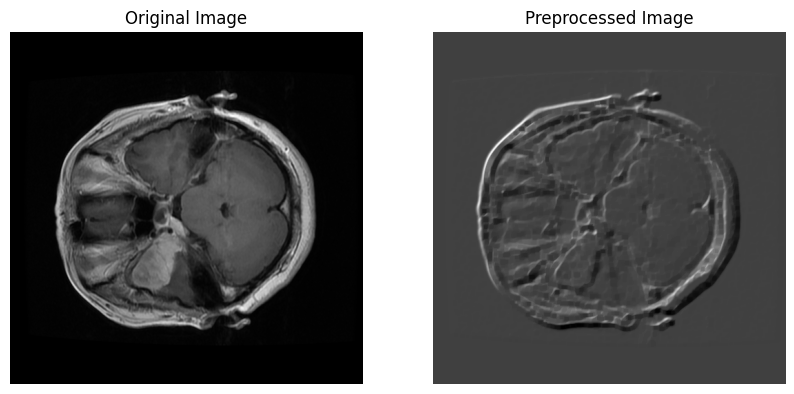

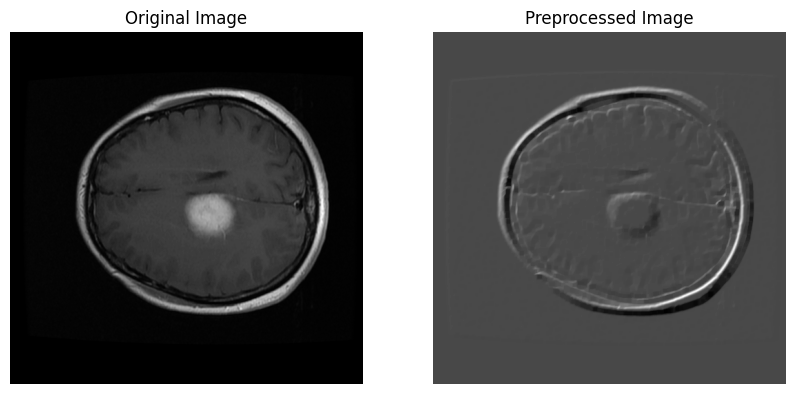

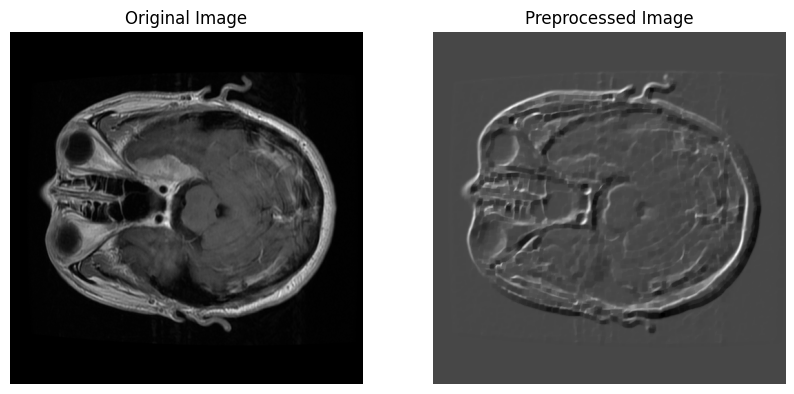

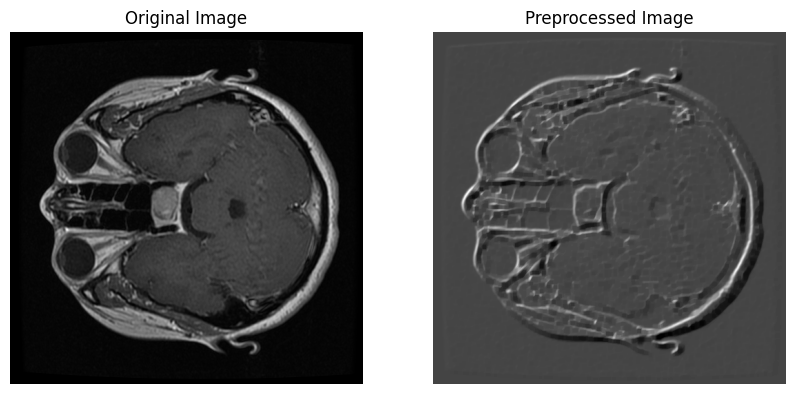

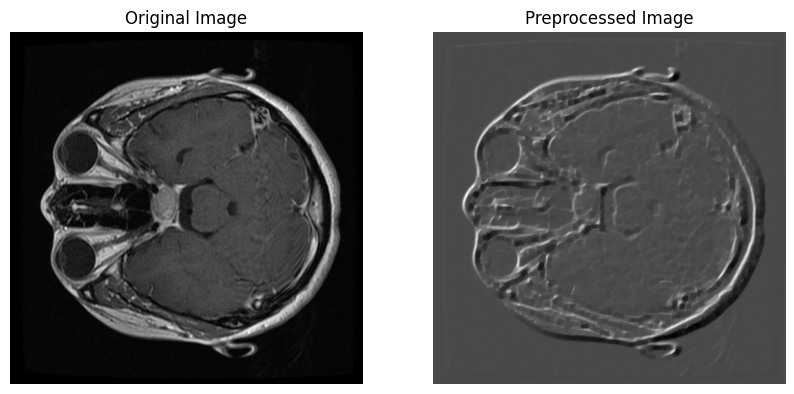

...

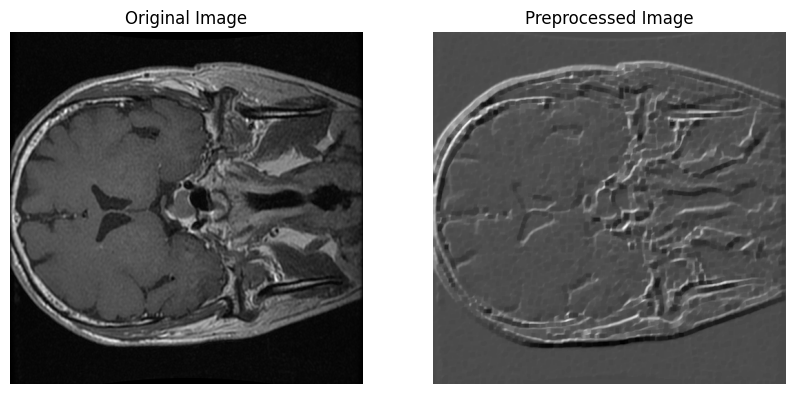

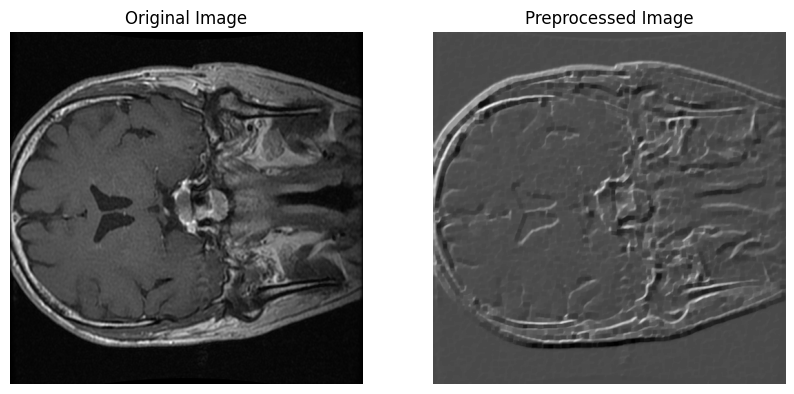

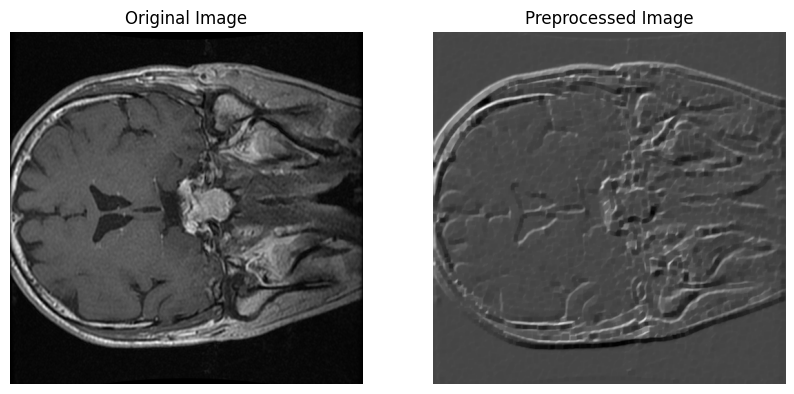

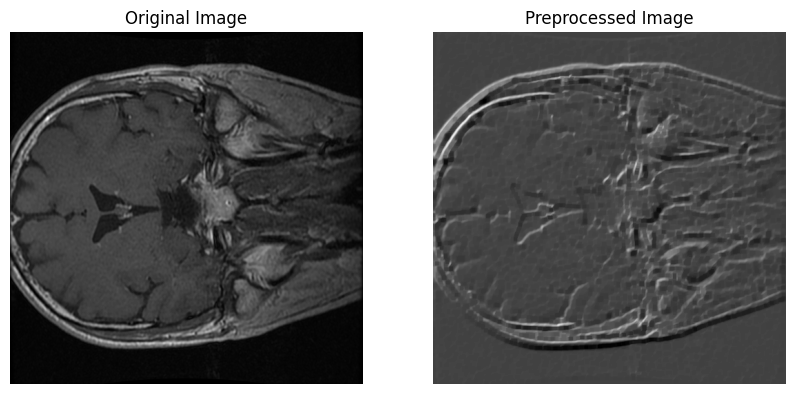

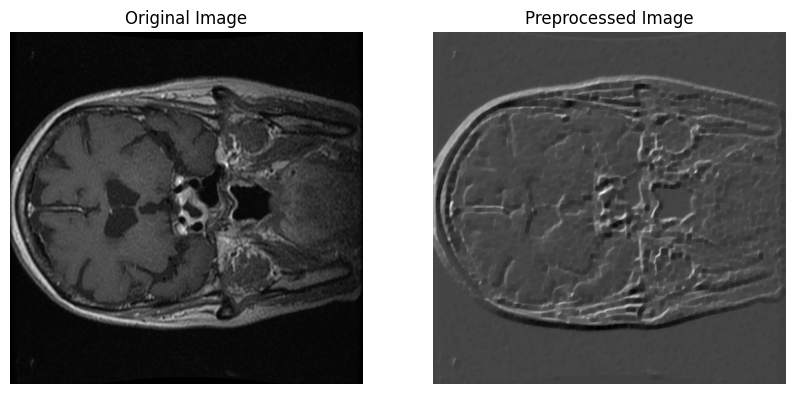

In [12]:
import os
import numpy as np
import h5py
import cv2
from skimage import exposure, morphology
from sklearn.preprocessing import StandardScaler
import matplotlib.pyplot as plt

def preprocess_image(image):
    """
    Apply advanced preprocessing techniques to enhance image quality.
    """
    original_image = image.copy()  # Keep original for comparison
    
    # Normalize the image
    image = image.astype(np.float32) / 255.0

    # Contrast stretching
    p2, p98 = np.percentile(image, (2, 98))
    image = exposure.rescale_intensity(image, in_range=(p2, p98))
    
    # Gaussian Blurring for noise reduction
    image = cv2.GaussianBlur(image, (5, 5), 0)
    
    # Edge Enhancement (Sobel operator)
    sobelx = cv2.Sobel(image, cv2.CV_64F, 1, 0, ksize=5)
    sobely = cv2.Sobel(image, cv2.CV_64F, 0, 1, ksize=5)
    image = cv2.addWeighted(sobelx, 0.5, sobely, 0.5, 0)
    
    # Morphological closing to close small holes
    kernel = np.ones((5,5), np.uint8)
    image = morphology.closing(image, kernel)
    
    # Standardize the image (feature-wise standardization)
    scaler = StandardScaler()
    image = scaler.fit_transform(image.reshape(-1, 1)).reshape(image.shape)
    
    return original_image, image

def plot_comparison(original, processed):
    """
    Plot the original and processed images side-by-side.
    """
    fig, ax = plt.subplots(1, 2, figsize=(10, 5))
    ax[0].imshow(original, cmap='gray')
    ax[0].title.set_text('Original Image')
    ax[0].axis('off')
    
    ax[1].imshow(processed, cmap='gray')
    ax[1].title.set_text('Preprocessed Image')
    ax[1].axis('off')
    
    plt.show()

def load_and_display_images(image_dir, labels_mat_file, image_key='cjdata/image', num_examples=100):
    """
    Load, preprocess, and display a number of image examples.
    """
    with h5py.File(labels_mat_file, 'r') as file:
        all_global_labels = np.array(file['cvind'][0])

    file_names = sorted([f for f in os.listdir(image_dir) if f.endswith('.mat')])
    displayed = 0

    for file_name in file_names:
        if displayed >= num_examples:
            break
        mat_path = os.path.join(image_dir, file_name)
        with h5py.File(mat_path, 'r') as mat_file:
            image_data = np.array(mat_file[image_key])
            original, processed = preprocess_image(image_data)
            plot_comparison(original, processed)
        displayed += 1

image_dir = '/kaggle/input/brain-tumor/brainTumorDataPublic_1766 2/brainTumorDataPublic_1766'
labels_mat_file = '/kaggle/input/brain-tumor/cvind.mat'
load_and_display_images(image_dir, labels_mat_file)

# Loading the Cross-Val and Train Data in a DataFrame

In [13]:
import h5py
import os
import pandas as pd

# Load the cross-validation indices
cvind_path = '/kaggle/input/brain-tumor/cvind.mat'
with h5py.File(cvind_path, 'r') as file:
    cv_indices = file['cvind'][0]  # Access the first row of the dataset

def extract_data_from_mat(file_path, index):
    with h5py.File(file_path, 'r') as file:
        pid = file['cjdata/PID'][()][0][0]
        label = int(file['cjdata/label'][()][0][0])
        image_shape = file['cjdata/image'][()].shape
        tumor_mask_shape = file['cjdata/tumorMask'][()].shape
        cv_fold = cv_indices[index]  # Use the index to get the CV fold number
    return pid, label, image_shape, tumor_mask_shape, cv_fold

def process_directory(directory_path):
    data = []
    files = [f for f in os.listdir(directory_path) if f.endswith('.mat')]
    for idx, filename in enumerate(files):
        if idx < len(cv_indices):  # Ensure index is within the range of cv_indices
            file_path = os.path.join(directory_path, filename)
            pid, label, image_shape, tumor_mask_shape, cv_fold = extract_data_from_mat(file_path, idx)
            data.append({'Filename': filename, 'Patient ID': pid, 'Tumor Label': label, 'Image Shape': image_shape, 'Tumor Mask Shape': tumor_mask_shape, 'CV Fold': cv_fold})
    return pd.DataFrame(data)

# Usage
directory_path = '/kaggle/input/brain-tumor/brainTumorDataPublic_1766 2/brainTumorDataPublic_1766'
df = process_directory(directory_path)
print(df)

      Filename  Patient ID  Tumor Label Image Shape Tumor Mask Shape  CV Fold
0     2912.mat          77            2  (512, 512)       (512, 512)      5.0
1     2011.mat          77            2  (512, 512)       (512, 512)      5.0
2     3027.mat          77            2  (512, 512)       (512, 512)      5.0
3     1912.mat          77            2  (512, 512)       (512, 512)      5.0
4     3023.mat          77            2  (512, 512)       (512, 512)      5.0
...        ...         ...          ...         ...              ...      ...
3059  1248.mat          49            3  (512, 512)       (512, 512)      4.0
3060  2374.mat          77            2  (512, 512)       (512, 512)      4.0
3061  1437.mat          57            3  (512, 512)       (512, 512)      4.0
3062  1119.mat          49            3  (512, 512)       (512, 512)      2.0
3063  1008.mat          49            3  (512, 512)       (512, 512)      1.0

[3064 rows x 6 columns]


# Generating Mask Overlays for Tumors

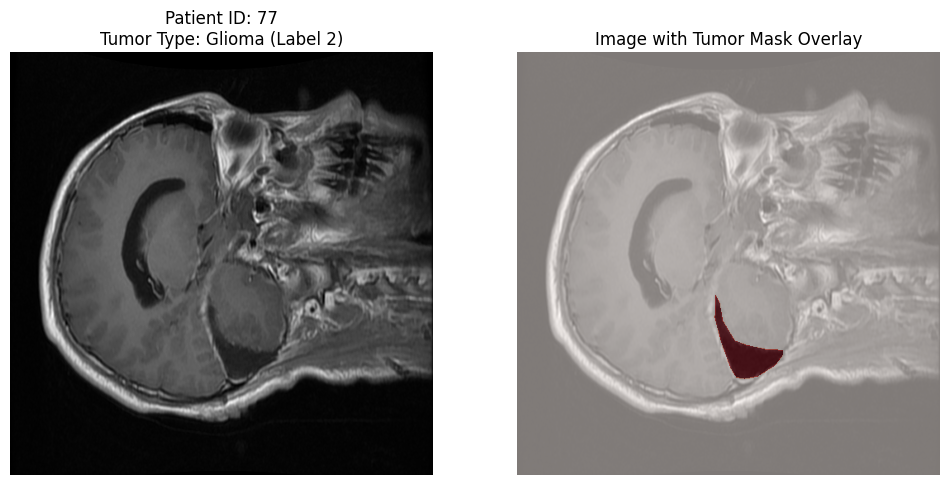

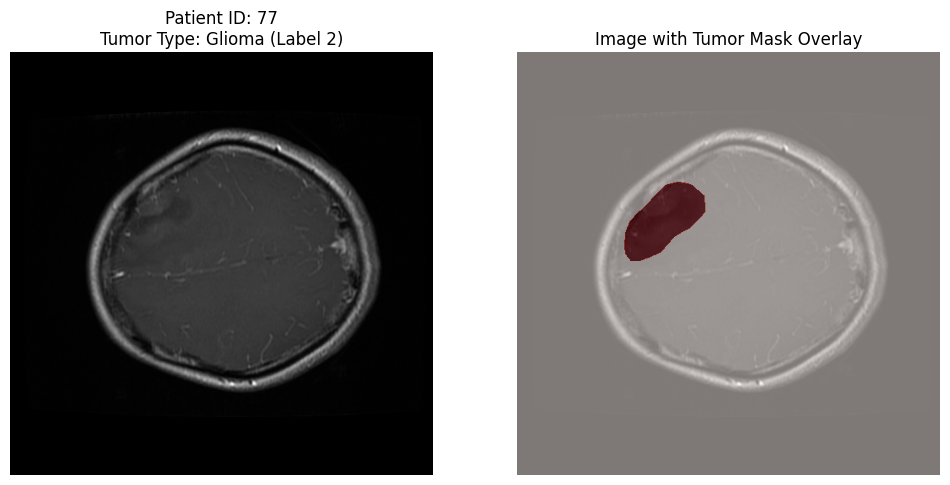

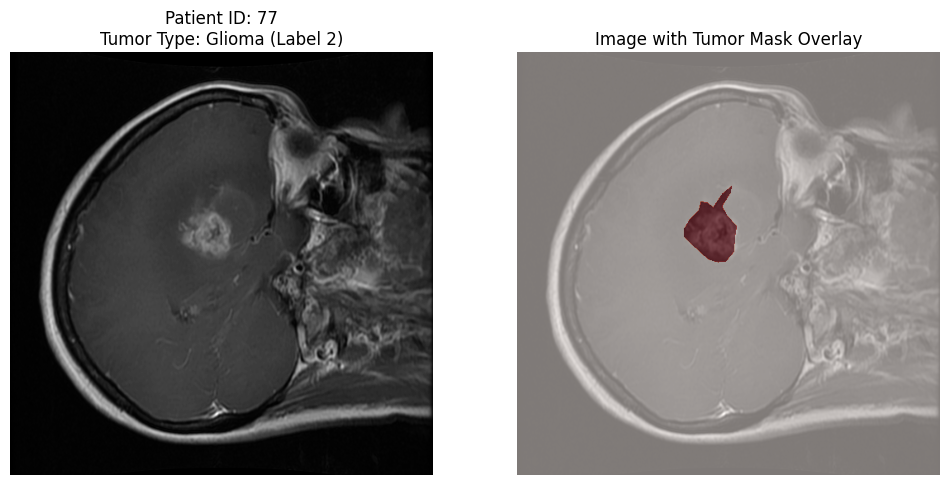

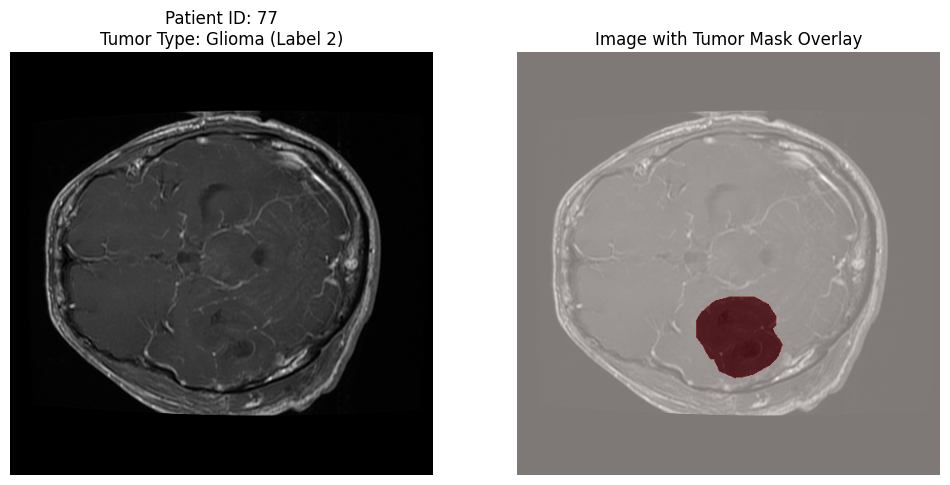

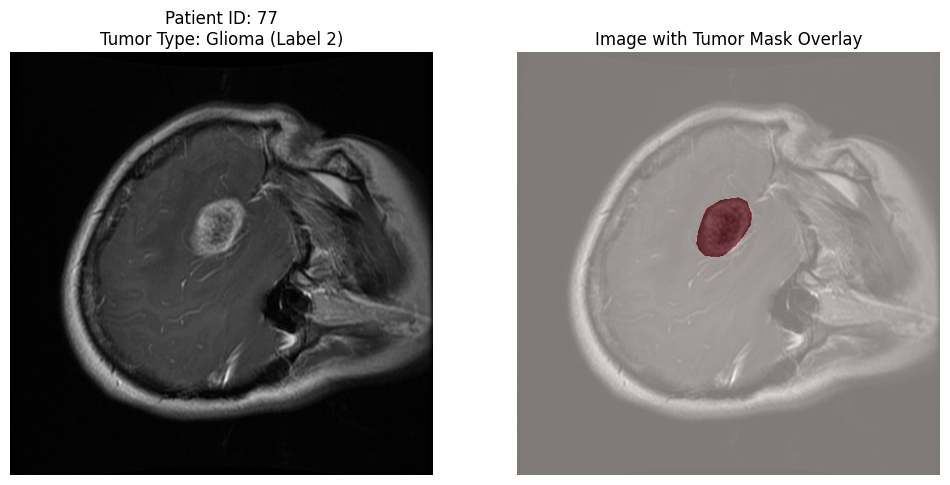

...

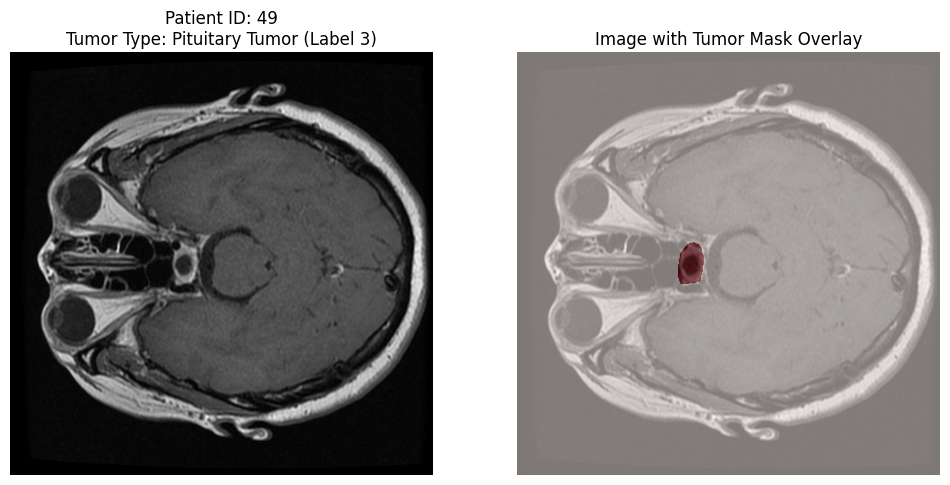

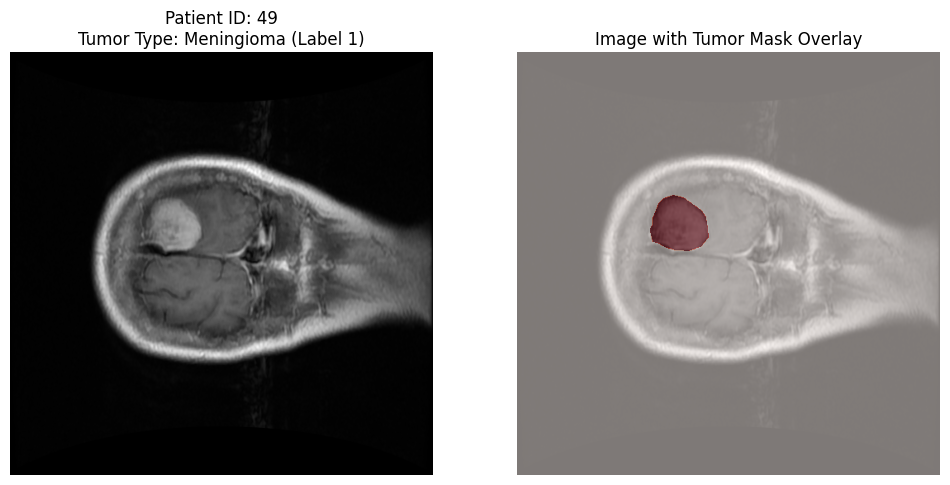

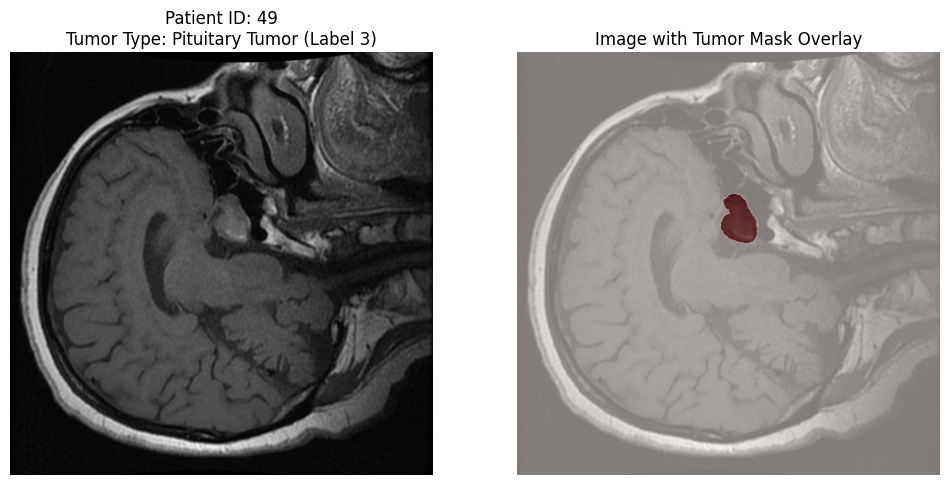

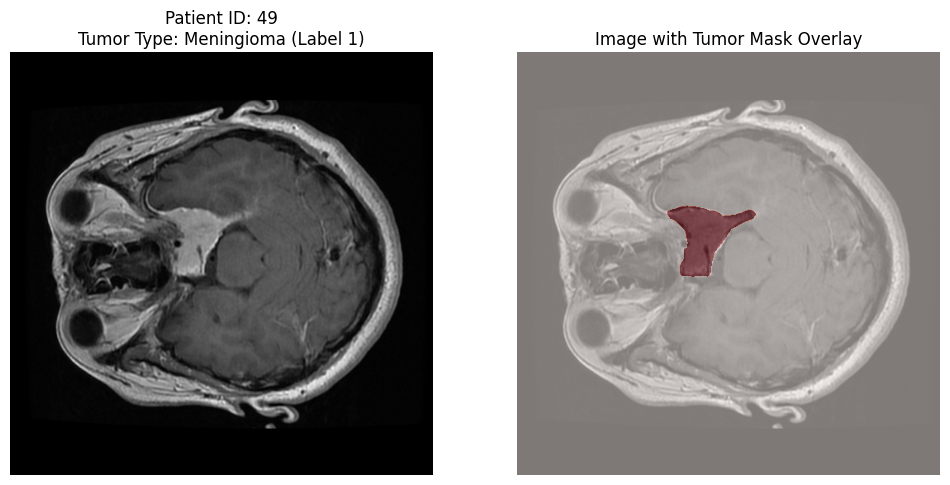

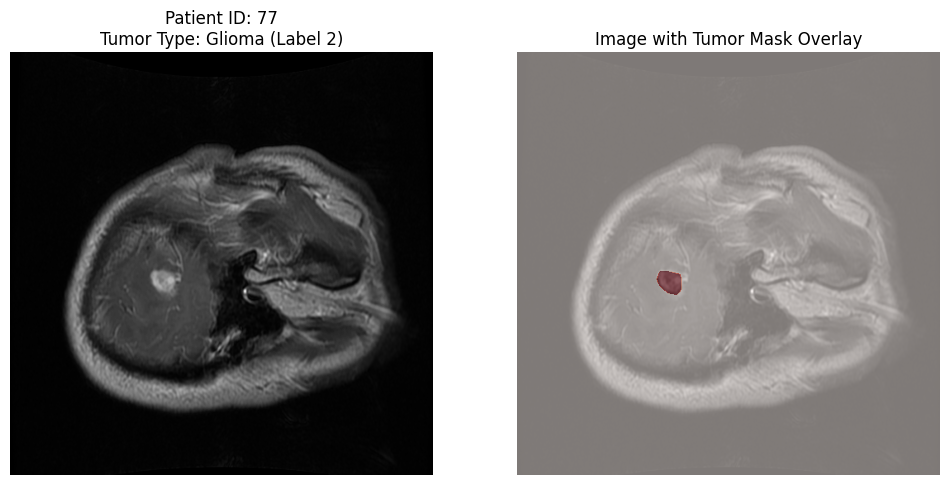

KeyboardInterrupt: 

In [14]:
import h5py
import os
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

# Load the cross-validation indices
cvind_path = '/kaggle/input/brain-tumor/cvind.mat'
with h5py.File(cvind_path, 'r') as file:
    cv_indices = file['cvind'][0]  # Access the first row of the dataset

def extract_and_plot_data_from_mat(file_path, index):
    with h5py.File(file_path, 'r') as file:
        image = np.array(file['cjdata/image'][()])
        mask = np.array(file['cjdata/tumorMask'][()])
        pid = file['cjdata/PID'][()][0][0]
        label = int(file['cjdata/label'][()][0][0])
        label_dict = {1: "Meningioma", 2: "Glioma", 3: "Pituitary Tumor"}
        cv_fold = cv_indices[index]
    
    # Plotting
    fig, ax = plt.subplots(1, 2, figsize=(12, 6))
    ax[0].imshow(image, cmap='gray')
    ax[0].set_title(f'Patient ID: {pid}\nTumor Type: {label_dict[label]} (Label {label})')
    ax[0].axis('off')
    ax[1].imshow(image, cmap='gray')
    ax[1].imshow(mask, alpha=0.5, cmap='Reds')  # Red color mask with transparency
    ax[1].set_title('Image with Tumor Mask Overlay')
    ax[1].axis('off')
    plt.show()
    return pid, label, image.shape, mask.shape, cv_fold

def process_directory_and_plot(directory_path):
    files = [f for f in os.listdir(directory_path) if f.endswith('.mat')]
    for idx, filename in enumerate(files):
        if idx < len(cv_indices):  # Ensure index is within the range of cv_indices
            file_path = os.path.join(directory_path, filename)
            extract_and_plot_data_from_mat(file_path, idx)

# Usage
directory_path = '/kaggle/input/brain-tumor/brainTumorDataPublic_1766 2/brainTumorDataPublic_1766'
process_directory_and_plot(directory_path)

# Model Training

In [15]:
import numpy as np
import tensorflow as tf
from tensorflow.keras.applications import VGG16
from tensorflow.keras.layers import Dense, Flatten, GlobalAveragePooling2D
from tensorflow.keras.models import Model
from tensorflow.keras.utils import to_categorical

# Load and preprocess images
def load_and_preprocess_image(file_path):
    with h5py.File(file_path, 'r') as file:
        image = np.array(file['cjdata/image'][()])
    image = image / 255.0  # Normalize to [0, 1]
    image = np.stack((image,)*3, axis=-1)  # Convert grayscale to RGB by repeating the channel
    image = tf.image.resize(image, (224, 224))  # Resize to match the model's expected input
    return image


import numpy as np
from tensorflow.keras.utils import to_categorical

def prepare_dataset(df, directory_path):
    images = []
    labels = []
    for idx, row in df.iterrows():
        file_path = os.path.join(directory_path, row['Filename'])
        image = load_and_preprocess_image(file_path)
        label = row['Tumor Label']
        images.append(image)
        labels.append(label)
    images = np.array(images)
    labels = np.array(labels)  # Convert list to numpy array for operations
    labels = to_categorical(labels - 1)  # Subtract 1 from each label if they start from 1, then one-hot encode
    return images, labels


# Define the model
# Modify the create_model function to accommodate four classes
def create_model(input_shape, num_classes):
    base_model = VGG16(weights='imagenet', include_top=False, input_shape=input_shape)
    x = GlobalAveragePooling2D()(base_model.output)
    x = Dense(1024, activation='relu')(x)
    predictions = Dense(num_classes, activation='softmax')(x)
    model = Model(inputs=base_model.input, outputs=predictions)
    for layer in base_model.layers:
        layer.trainable = False
    model.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])
    return model

model = create_model((224, 224, 3), 4)  # Now using 4 instead of 3


# Main execution flow

# Usage
directory_path = '/kaggle/input/brain-tumor/brainTumorDataPublic_1766 2/brainTumorDataPublic_1766'
df = process_directory(directory_path)
print(df)
images, labels = prepare_dataset(df, directory_path)
model = create_model(num_classes=3)
model.fit(images, labels, epochs=10, validation_split=0.2)  # Use some data for validation

# Evaluate the model
# model.evaluate(test_images, test_labels)

      Filename  Patient ID  Tumor Label Image Shape Tumor Mask Shape  CV Fold
0     2912.mat          77            2  (512, 512)       (512, 512)      5.0
1     2011.mat          77            2  (512, 512)       (512, 512)      5.0
2     3027.mat          77            2  (512, 512)       (512, 512)      5.0
3     1912.mat          77            2  (512, 512)       (512, 512)      5.0
4     3023.mat          77            2  (512, 512)       (512, 512)      5.0
...        ...         ...          ...         ...              ...      ...
3059  1248.mat          49            3  (512, 512)       (512, 512)      4.0
3060  2374.mat          77            2  (512, 512)       (512, 512)      4.0
3061  1437.mat          57            3  (512, 512)       (512, 512)      4.0
3062  1119.mat          49            3  (512, 512)       (512, 512)      2.0
3063  1008.mat          49            3  (512, 512)       (512, 512)      1.0

[3064 rows x 6 columns]


KeyboardInterrupt: 

# VGG-16

In [16]:
import numpy as np
import tensorflow as tf
import h5py
from tensorflow.keras.applications import VGG16
from tensorflow.keras.layers import Dense, GlobalAveragePooling2D
from tensorflow.keras.models import Model
from tensorflow.keras.utils import to_categorical

def load_and_preprocess_image(file_path):
    with h5py.File(file_path, 'r') as file:
        image = np.array(file['cjdata/image'][()])
    image = image / 255.0  # Normalize to [0, 1]
    image = np.stack((image,)*3, axis=-1)  # Convert grayscale to RGB by repeating the channel
    image = tf.image.resize(image, (224, 224))  # Resize to match the model's expected input
    return image

def prepare_dataset(df, directory_path):
    images = []
    labels = []
    for idx, row in df.iterrows():
        file_path = os.path.join(directory_path, row['Filename'])
        image = load_and_preprocess_image(file_path)
        label = row['Tumor Label']
        images.append(image)
        labels.append(label)
    images = np.array(images)
    labels = np.array(labels)
    labels = to_categorical(labels - 1, num_classes=4)  # One-hot encode labels
    return images, labels

def create_model(input_shape, num_classes):
    base_model = VGG16(weights='imagenet', include_top=False, input_shape=input_shape)
    x = GlobalAveragePooling2D()(base_model.output)
    x = Dense(1024, activation='relu')(x)
    predictions = Dense(num_classes, activation='softmax')(x)
    model = Model(inputs=base_model.input, outputs=predictions)
    for layer in base_model.layers:
        layer.trainable = False
    model.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])
    return model

directory_path = '/kaggle/input/brain-tumor/brainTumorDataPublic_1766 2/brainTumorDataPublic_1766'
df = process_directory(directory_path)

images, labels = prepare_dataset(df, directory_path)
model = create_model((224, 224, 3), 4)

# Train the model
model.fit(images, labels, epochs=10, validation_split=0.2)

# Save the model
model.save('/kaggle/working/my_model.h5')  # Save as HDF5 file
# model.save('/kaggle/working/my_saved_model')  # This saves in the default SavedModel format

print("Model saved successfully.")

Epoch 1/10


2024-07-08 05:59:06.985398: E external/local_xla/xla/service/gpu/buffer_comparator.cc:1137] Difference at 0: 4.63498, expected 3.85968
2024-07-08 05:59:06.985447: E external/local_xla/xla/service/gpu/buffer_comparator.cc:1137] Difference at 3: 6.55784, expected 5.78254
2024-07-08 05:59:06.985456: E external/local_xla/xla/service/gpu/buffer_comparator.cc:1137] Difference at 4: 6.61282, expected 5.83752
2024-07-08 05:59:06.985464: E external/local_xla/xla/service/gpu/buffer_comparator.cc:1137] Difference at 6: 6.34499, expected 5.56968
2024-07-08 05:59:06.985472: E external/local_xla/xla/service/gpu/buffer_comparator.cc:1137] Difference at 7: 6.25159, expected 5.47629
2024-07-08 05:59:06.985480: E external/local_xla/xla/service/gpu/buffer_comparator.cc:1137] Difference at 8: 5.43964, expected 4.66434
2024-07-08 05:59:06.985488: E external/local_xla/xla/service/gpu/buffer_comparator.cc:1137] Difference at 9: 6.54333, expected 5.76803
2024-07-08 05:59:06.985496: E external/local_xla/xla/se

 2/77 ━━━━━━━━━━━━━━━━━━━━ 5s 70ms/step - accuracy: 0.1484 - loss: 1.5460  

I0000 00:00:1720418362.555392     102 device_compiler.h:186] Compiled cluster using XLA!  This line is logged at most once for the lifetime of the process.


76/77 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step - accuracy: 0.6724 - loss: 0.7081

2024-07-08 05:59:28.328965: E external/local_xla/xla/service/gpu/buffer_comparator.cc:1137] Difference at 0: 3.83445, expected 3.08393
2024-07-08 05:59:28.329052: E external/local_xla/xla/service/gpu/buffer_comparator.cc:1137] Difference at 1: 5.81387, expected 5.06335
2024-07-08 05:59:28.329070: E external/local_xla/xla/service/gpu/buffer_comparator.cc:1137] Difference at 2: 5.65478, expected 4.90426
2024-07-08 05:59:28.329091: E external/local_xla/xla/service/gpu/buffer_comparator.cc:1137] Difference at 3: 6.2384, expected 5.48788
2024-07-08 05:59:28.329105: E external/local_xla/xla/service/gpu/buffer_comparator.cc:1137] Difference at 4: 5.85899, expected 5.10847
2024-07-08 05:59:28.329118: E external/local_xla/xla/service/gpu/buffer_comparator.cc:1137] Difference at 5: 5.234, expected 4.48348
2024-07-08 05:59:28.329130: E external/local_xla/xla/service/gpu/buffer_comparator.cc:1137] Difference at 6: 5.17387, expected 4.42335
2024-07-08 05:59:28.329142: E external/local_xla/xla/servi

77/77 ━━━━━━━━━━━━━━━━━━━━ 0s 194ms/step - accuracy: 0.6738 - loss: 5.7010

2024-07-08 05:59:39.940961: E external/local_xla/xla/service/gpu/buffer_comparator.cc:1137] Difference at 50176: 3.09291, expected 2.38321
2024-07-08 05:59:39.941029: E external/local_xla/xla/service/gpu/buffer_comparator.cc:1137] Difference at 50177: 5.88251, expected 5.1728
2024-07-08 05:59:39.941039: E external/local_xla/xla/service/gpu/buffer_comparator.cc:1137] Difference at 50178: 5.48389, expected 4.77418
2024-07-08 05:59:39.941048: E external/local_xla/xla/service/gpu/buffer_comparator.cc:1137] Difference at 50179: 5.23066, expected 4.52095
2024-07-08 05:59:39.941056: E external/local_xla/xla/service/gpu/buffer_comparator.cc:1137] Difference at 50180: 5.78972, expected 5.08001
2024-07-08 05:59:39.941063: E external/local_xla/xla/service/gpu/buffer_comparator.cc:1137] Difference at 50181: 4.97856, expected 4.26885
2024-07-08 05:59:39.941071: E external/local_xla/xla/service/gpu/buffer_comparator.cc:1137] Difference at 50182: 4.36704, expected 3.65734
2024-07-08 05:59:39.941079: 

77/77 ━━━━━━━━━━━━━━━━━━━━ 40s 275ms/step - accuracy: 0.6752 - loss: 10.5660 - val_accuracy: 0.8532 - val_loss: 360.3151
Epoch 2/10
77/77 ━━━━━━━━━━━━━━━━━━━━ 6s 83ms/step - accuracy: 0.8476 - loss: 2.4520 - val_accuracy: 0.8777 - val_loss: 554.7236
Epoch 3/10
77/77 ━━━━━━━━━━━━━━━━━━━━ 6s 83ms/step - accuracy: 0.8859 - loss: 19.6538 - val_accuracy: 0.9086 - val_loss: 604.3075
Epoch 4/10
77/77 ━━━━━━━━━━━━━━━━━━━━ 6s 83ms/step - accuracy: 0.9094 - loss: 11.9158 - val_accuracy: 0.8679 - val_loss: 812.5484
Epoch 5/10
77/77 ━━━━━━━━━━━━━━━━━━━━ 6s 83ms/step - accuracy: 0.8989 - loss: 7.1359 - val_accuracy: 0.8581 - val_loss: 885.1967
Epoch 6/10
77/77 ━━━━━━━━━━━━━━━━━━━━ 6s 83ms/step - accuracy: 0.9167 - loss: 12.5621 - val_accuracy: 0.9021 - val_loss: 926.1252
Epoch 7/10
77/77 ━━━━━━━━━━━━━━━━━━━━ 6s 83ms/step - accuracy: 0.9328 - loss: 4.2279 - val_accuracy: 0.9005 - val_loss: 1050.5679
Epoch 8/10
77/77 ━━━━━━━━━━━━━━━━━━━━ 6s 83ms/step - accuracy: 0.9417 - loss: 17.3366 - val_accuracy:

In [6]:
import os
import numpy as np
import pandas as pd
import tensorflow as tf
import h5py
from tensorflow.keras.applications import VGG16
from tensorflow.keras.layers import Dense, GlobalAveragePooling2D
from tensorflow.keras.models import Model
from tensorflow.keras.utils import to_categorical
from sklearn.model_selection import train_test_split
import os
import pandas as pd

def process_directory(directory_path):
    """
    Process the directory to create a DataFrame mapping filenames to labels.
    Assumes filenames might contain labels followed by an underscore, e.g., '1_filename.mat'.
    If no underscore is present, it assumes no label is encoded in the filename.
    """
    data = []
    for filename in os.listdir(directory_path):
        if filename.endswith('.mat'):
            parts = filename.split('_')
            if len(parts) > 1 and parts[0].isdigit():
                # Label is the numeric part before the first underscore
                label = int(parts[0])
            else:
                # Default label if no valid label is found
                label = -1  # You might choose to handle this case differently
            data.append({'Filename': filename, 'Tumor Label': label})
    return pd.DataFrame(data)



def load_and_preprocess_image(file_path):
    with h5py.File(file_path, 'r') as file:
        image = np.array(file['cjdata/image'][()])
    image = image / 255.0  # Normalize to [0, 1]
    image = np.stack((image,)*3, axis=-1)  # Convert grayscale to RGB
    image = tf.image.resize(image, (224, 224))  # Resize to match the model's expected input
    return image

def prepare_dataset(df, directory_path):
    images = []
    labels = []
    for _, row in df.iterrows():
        file_path = os.path.join(directory_path, row['Filename'])
        image = load_and_preprocess_image(file_path)
        labels.append(row['Tumor Label'])
        images.append(image)
    images = np.array(images)
    labels = to_categorical(np.array(labels) - 1, num_classes=4)  # One-hot encode labels
    return images, labels

def create_model(input_shape, num_classes):
    base_model = VGG16(weights='imagenet', include_top=False, input_shape=input_shape)
    x = GlobalAveragePooling2D()(base_model.output)
    x = Dense(1024, activation='relu')(x)
    predictions = Dense(num_classes, activation='softmax')(x)
    model = Model(inputs=base_model.input, outputs=predictions)
    for layer in base_model.layers:
        layer.trainable = False  # Freeze the layers of the base model
    model.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])
    return model
    
# Main execution flow
directory_path = '/kaggle/input/brain-tumor/brainTumorDataPublic_1766 2/brainTumorDataPublic_1766'
df = process_directory(directory_path)
images, labels = prepare_dataset(df, directory_path)

# Split the dataset into training and testing sets
train_images, test_images, train_labels, test_labels = train_test_split(images, labels, test_size=0.2, random_state=42)

# Create and train the model
model = create_model((224, 224, 3), 4)
model.fit(train_images, train_labels, epochs=10, validation_split=0.2)

# Evaluate the model
loss, accuracy = model.evaluate(test_images, test_labels)
print(f"Test Loss: {loss}, Test Accuracy: {accuracy}")

# Save the model
model.save('/kaggle/working/my_model.h5')
print("Model saved successfully.")

58889256/58889256 ━━━━━━━━━━━━━━━━━━━━ 3s 0us/step
Epoch 1/10


2024-07-08 08:02:46.360425: E external/local_xla/xla/service/gpu/buffer_comparator.cc:1137] Difference at 0: 4.63498, expected 3.85968
2024-07-08 08:02:46.360489: E external/local_xla/xla/service/gpu/buffer_comparator.cc:1137] Difference at 3: 6.55784, expected 5.78254
2024-07-08 08:02:46.360504: E external/local_xla/xla/service/gpu/buffer_comparator.cc:1137] Difference at 4: 6.61282, expected 5.83752
2024-07-08 08:02:46.360518: E external/local_xla/xla/service/gpu/buffer_comparator.cc:1137] Difference at 6: 6.34499, expected 5.56968
2024-07-08 08:02:46.360549: E external/local_xla/xla/service/gpu/buffer_comparator.cc:1137] Difference at 7: 6.25159, expected 5.47629
2024-07-08 08:02:46.360563: E external/local_xla/xla/service/gpu/buffer_comparator.cc:1137] Difference at 8: 5.43964, expected 4.66434
2024-07-08 08:02:46.360574: E external/local_xla/xla/service/gpu/buffer_comparator.cc:1137] Difference at 9: 6.54333, expected 5.76803
2024-07-08 08:02:46.360587: E external/local_xla/xla/se

 2/62 ━━━━━━━━━━━━━━━━━━━━ 4s 74ms/step - accuracy: 0.6484 - loss: 0.7850  

I0000 00:00:1720425781.874761     122 device_compiler.h:186] Compiled cluster using XLA!  This line is logged at most once for the lifetime of the process.


61/62 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step - accuracy: 0.9639 - loss: 0.0825

2024-07-08 08:03:06.364020: E external/local_xla/xla/service/gpu/buffer_comparator.cc:1137] Difference at 50176: 4.39009, expected 3.53025
2024-07-08 08:03:06.364086: E external/local_xla/xla/service/gpu/buffer_comparator.cc:1137] Difference at 50177: 5.40727, expected 4.54742
2024-07-08 08:03:06.364096: E external/local_xla/xla/service/gpu/buffer_comparator.cc:1137] Difference at 50178: 5.56026, expected 4.70042
2024-07-08 08:03:06.364104: E external/local_xla/xla/service/gpu/buffer_comparator.cc:1137] Difference at 50179: 5.58812, expected 4.72827
2024-07-08 08:03:06.364112: E external/local_xla/xla/service/gpu/buffer_comparator.cc:1137] Difference at 50180: 4.9643, expected 4.10445
2024-07-08 08:03:06.364120: E external/local_xla/xla/service/gpu/buffer_comparator.cc:1137] Difference at 50181: 5.19898, expected 4.33914
2024-07-08 08:03:06.364128: E external/local_xla/xla/service/gpu/buffer_comparator.cc:1137] Difference at 50182: 5.47066, expected 4.61082
2024-07-08 08:03:06.364135: 

62/62 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step - accuracy: 0.9644 - loss: 0.0815

2024-07-08 08:03:14.050695: E external/local_xla/xla/service/gpu/buffer_comparator.cc:1137] Difference at 0: 4.18376, expected 3.42997
2024-07-08 08:03:14.050751: E external/local_xla/xla/service/gpu/buffer_comparator.cc:1137] Difference at 1: 5.33565, expected 4.58186
2024-07-08 08:03:14.050761: E external/local_xla/xla/service/gpu/buffer_comparator.cc:1137] Difference at 2: 4.70509, expected 3.95129
2024-07-08 08:03:14.050769: E external/local_xla/xla/service/gpu/buffer_comparator.cc:1137] Difference at 3: 5.361, expected 4.60721
2024-07-08 08:03:14.050777: E external/local_xla/xla/service/gpu/buffer_comparator.cc:1137] Difference at 4: 5.17522, expected 4.42143
2024-07-08 08:03:14.050784: E external/local_xla/xla/service/gpu/buffer_comparator.cc:1137] Difference at 5: 4.39461, expected 3.64082
2024-07-08 08:03:14.050792: E external/local_xla/xla/service/gpu/buffer_comparator.cc:1137] Difference at 6: 4.45438, expected 3.70059
2024-07-08 08:03:14.050800: E external/local_xla/xla/serv

62/62 ━━━━━━━━━━━━━━━━━━━━ 37s 294ms/step - accuracy: 0.9648 - loss: 0.0805 - val_accuracy: 1.0000 - val_loss: 2.9377e-08
Epoch 2/10
62/62 ━━━━━━━━━━━━━━━━━━━━ 5s 83ms/step - accuracy: 1.0000 - loss: 3.1174e-08 - val_accuracy: 1.0000 - val_loss: 2.7921e-08
Epoch 3/10
62/62 ━━━━━━━━━━━━━━━━━━━━ 5s 83ms/step - accuracy: 1.0000 - loss: 3.3321e-08 - val_accuracy: 1.0000 - val_loss: 2.7678e-08
Epoch 4/10
62/62 ━━━━━━━━━━━━━━━━━━━━ 5s 83ms/step - accuracy: 1.0000 - loss: 3.6498e-08 - val_accuracy: 1.0000 - val_loss: 2.7678e-08
Epoch 5/10
62/62 ━━━━━━━━━━━━━━━━━━━━ 5s 83ms/step - accuracy: 1.0000 - loss: 2.0923e-08 - val_accuracy: 1.0000 - val_loss: 2.7435e-08
Epoch 6/10
62/62 ━━━━━━━━━━━━━━━━━━━━ 5s 82ms/step - accuracy: 1.0000 - loss: 2.9672e-08 - val_accuracy: 1.0000 - val_loss: 2.7435e-08
Epoch 7/10
62/62 ━━━━━━━━━━━━━━━━━━━━ 5s 82ms/step - accuracy: 1.0000 - loss: 3.6824e-08 - val_accuracy: 1.0000 - val_loss: 2.6950e-08
Epoch 8/10
62/62 ━━━━━━━━━━━━━━━━━━━━ 5s 82ms/step - accuracy: 1.000

2024-07-08 08:04:07.951179: E external/local_xla/xla/service/gpu/buffer_comparator.cc:1137] Difference at 50176: 3.09291, expected 2.38321
2024-07-08 08:04:07.951238: E external/local_xla/xla/service/gpu/buffer_comparator.cc:1137] Difference at 50177: 5.88251, expected 5.1728
2024-07-08 08:04:07.951252: E external/local_xla/xla/service/gpu/buffer_comparator.cc:1137] Difference at 50178: 5.48389, expected 4.77418
2024-07-08 08:04:07.951267: E external/local_xla/xla/service/gpu/buffer_comparator.cc:1137] Difference at 50179: 5.23066, expected 4.52095
2024-07-08 08:04:07.951280: E external/local_xla/xla/service/gpu/buffer_comparator.cc:1137] Difference at 50180: 5.78972, expected 5.08001
2024-07-08 08:04:07.951290: E external/local_xla/xla/service/gpu/buffer_comparator.cc:1137] Difference at 50181: 4.97856, expected 4.26885
2024-07-08 08:04:07.951301: E external/local_xla/xla/service/gpu/buffer_comparator.cc:1137] Difference at 50182: 4.36704, expected 3.65734
2024-07-08 08:04:07.951312: 

20/20 ━━━━━━━━━━━━━━━━━━━━ 5s 262ms/step - accuracy: 1.0000 - loss: 1.0164e-08
Test Loss: 1.3029398893138477e-08, Test Accuracy: 1.0
Model saved successfully.


In [11]:
import numpy as np
import tensorflow as tf
import h5py
from tensorflow.keras.models import load_model

def load_and_preprocess_image(file_path):
    with h5py.File(file_path, 'r') as file:
        image = np.array(file['cjdata/image'][()])
    image = image / 255.0  # Normalize to [0, 1]
    image = np.stack((image,)*3, axis=-1)  # Convert grayscale to RGB
    image = tf.image.resize(image, (224, 224))  # Resize for the model
    return image

def predict_image(model, file_path):
    # Load and preprocess the image
    image = load_and_preprocess_image(file_path)
    image = np.expand_dims(image, axis=0)  # Add batch dimension

    # Predict
    prediction = model.predict(image)
    predicted_class = np.argmax(prediction, axis=1)
    return predicted_class

def get_true_label(file_path):
    with h5py.File(file_path, 'r') as file:
        label = int(file['cjdata/label'][0])
    return label

# Load the model
model = load_model('/kaggle/working/my_model.h5')

# Provide the path to your image
file_path = '/kaggle/input/brain-tumor/brainTumorDataPublic_1766 2/brainTumorDataPublic_1766/1116.mat'

# Get prediction
predicted_class = predict_image(model, file_path)
true_label = get_true_label(file_path)  # Get the true label for verification

# Adjusting the predicted class and true label index based on your label encoding
predicted_class = predicted_class[0] + 1
print(f"Predicted Class: {predicted_class}, True Label: {true_label}")

# Verify the prediction
if predicted_class == true_label:
    print("The prediction is correct!")
else:
    print("The prediction is incorrect.")

2024-07-08 08:31:06.291034: E external/local_xla/xla/service/gpu/buffer_comparator.cc:1137] Difference at 0: 4.42855, expected 3.64542
2024-07-08 08:31:06.291096: E external/local_xla/xla/service/gpu/buffer_comparator.cc:1137] Difference at 1: 5.87036, expected 5.08723
2024-07-08 08:31:06.291106: E external/local_xla/xla/service/gpu/buffer_comparator.cc:1137] Difference at 2: 6.04003, expected 5.2569
2024-07-08 08:31:06.291114: E external/local_xla/xla/service/gpu/buffer_comparator.cc:1137] Difference at 3: 6.22034, expected 5.43722
2024-07-08 08:31:06.291122: E external/local_xla/xla/service/gpu/buffer_comparator.cc:1137] Difference at 4: 4.90026, expected 4.11714
2024-07-08 08:31:06.291130: E external/local_xla/xla/service/gpu/buffer_comparator.cc:1137] Difference at 5: 5.21068, expected 4.42756
2024-07-08 08:31:06.291138: E external/local_xla/xla/service/gpu/buffer_comparator.cc:1137] Difference at 6: 5.92061, expected 5.13748
2024-07-08 08:31:06.291146: E external/local_xla/xla/ser

1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step
Predicted Class: 3, True Label: 3
The prediction is correct!


/tmp/ipykernel_34/411605856.py:26: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = int(file['cjdata/label'][0])  # Assuming label is stored at this location


# Evaluation Metrics

In [8]:
def evaluate_model(test_images, test_labels, model_path):
    # Load the model
    model = load_model(model_path)
    
    # Evaluate the model on the test set
    loss, accuracy = model.evaluate(test_images, test_labels)
    print(f"Test Loss: {loss}, Test Accuracy: {accuracy}")
    
    # Get predictions
    predictions = model.predict(test_images)
    predicted_classes = np.argmax(predictions, axis=1)
    true_classes = np.argmax(test_labels, axis=1)
    
    # Identify unique classes and create corresponding target names
    unique_classes = np.unique(true_classes)
    target_names = [f'Class{i}' for i in unique_classes + 1]
    
    # Generate a classification report
    print("\nClassification Report:")
    print(classification_report(true_classes, predicted_classes, target_names=target_names))
    
    # Compute and print confusion matrix
    cm = confusion_matrix(true_classes, predicted_classes)
    print("\nConfusion Matrix:")
    print(cm)

model_path = '/kaggle/working/my_model.h5'
evaluate_model(test_images, test_labels, model_path)

20/20 ━━━━━━━━━━━━━━━━━━━━ 3s 84ms/step - accuracy: 1.0000 - loss: 1.0164e-08
Test Loss: 1.3029398893138477e-08, Test Accuracy: 1.0
20/20 ━━━━━━━━━━━━━━━━━━━━ 2s 81ms/step

Classification Report:
              precision    recall  f1-score   support

      Class3       1.00      1.00      1.00       613

    accuracy                           1.00       613
   macro avg       1.00      1.00      1.00       613
weighted avg       1.00      1.00      1.00       613


Confusion Matrix:
[[613]]


In [9]:
import numpy as np
from sklearn.model_selection import train_test_split

# Split the dataset into training and testing sets
train_images, test_images, train_labels, test_labels = train_test_split(
    images, labels, test_size=0.2, random_state=42, stratify=labels)  # Using stratified split if labels are categorical

# Print basic info about the test set
print(f"Number of test images: {test_images.shape[0]}")
print(f"Shape of test images: {test_images.shape}")
print(f"Shape of test labels: {test_labels.shape}")

# Print unique classes and their counts in the test set
unique_classes, counts = np.unique(np.argmax(test_labels, axis=1), return_counts=True)
print("Test label distribution:")
for cls, count in zip(unique_classes, counts):
    print(f"Class {cls}: {count} samples")

# Print details about a few test images
print("\nSample test image details:")
for i in range(min(5, test_images.shape[0])):
    print(f"Test Image {i + 1}:")
    print(f"  Pixel range: min={np.min(test_images[i])}, max={np.max(test_images[i])}")
    print(f"  Mean pixel value: {np.mean(test_images[i]):.2f}")
    print(f"  Standard deviation: {np.std(test_images[i]):.2f}")
    print(f"  Label: {np.argmax(test_labels[i])}")

Number of test images: 613
Shape of test images: (613, 224, 224, 3)
Shape of test labels: (613, 4)
Test label distribution:
Class 2: 613 samples

Sample test image details:
Test Image 1:
  Pixel range: min=0.0, max=10.351441383361816
  Mean pixel value: 2.35
  Standard deviation: 1.78
  Label: 2
Test Image 2:
  Pixel range: min=0.0, max=25.00477409362793
  Mean pixel value: 2.61
  Standard deviation: 4.14
  Label: 2
Test Image 3:
  Pixel range: min=0.0, max=9.181177139282227
  Mean pixel value: 1.62
  Standard deviation: 1.59
  Label: 2
Test Image 4:
  Pixel range: min=0.0, max=15.450128555297852
  Mean pixel value: 2.46
  Standard deviation: 2.51
  Label: 2
Test Image 5:
  Pixel range: min=0.0, max=9.828908920288086
  Mean pixel value: 1.92
  Standard deviation: 1.64
  Label: 2


Number of test images: 613
Shape of test images: (613, 224, 224, 3)
Shape of test labels: (613, 4)
Test filenames and their labels:
Filename: 1812.mat, Label: Class3
Filename: 2383.mat, Label: Class3
Filename: 424.mat, Label: Class3
Filename: 2845.mat, Label: Class3
Filename: 1517.mat, Label: Class3
Filename: 2088.mat, Label: Class3
Filename: 2899.mat, Label: Class3
Filename: 219.mat, Label: Class3
Filename: 1076.mat, Label: Class3
Filename: 2636.mat, Label: Class3
Filename: 2937.mat, Label: Class3
Filename: 2100.mat, Label: Class3
Filename: 624.mat, Label: Class3
Filename: 1075.mat, Label: Class3
Filename: 1663.mat, Label: Class3
Filename: 1176.mat, Label: Class3
Filename: 1266.mat, Label: Class3
Filename: 524.mat, Label: Class3
Filename: 155.mat, Label: Class3
Filename: 2548.mat, Label: Class3
Filename: 1373.mat, Label: Class3
Filename: 309.mat, Label: Class3
Filename: 2083.mat, Label: Class3
Filename: 2680.mat, Label: Class3
Filename: 2301.mat, Label: Class3
Filename: 2046.mat, Labe

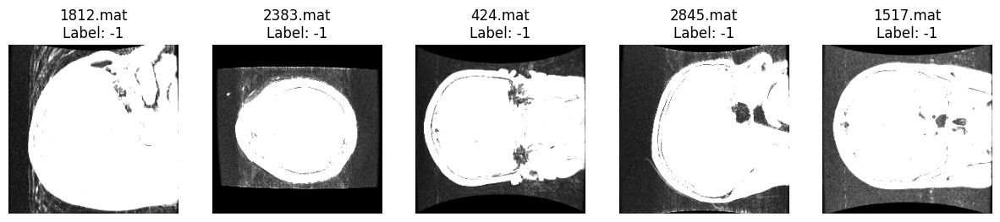

In [10]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split

# Split the dataset into training and testing sets with filenames included
train_df, test_df = train_test_split(df, test_size=0.2, random_state=42, stratify=df['Tumor Label'])

# Extract images and labels for the test set based on indices from the split DataFrame
test_images = images[test_df.index]
test_labels = labels[test_df.index]

# Print basic info about the test set
print(f"Number of test images: {test_images.shape[0]}")
print(f"Shape of test images: {test_images.shape}")
print(f"Shape of test labels: {test_labels.shape}")

# Print filenames and label distribution
print("Test filenames and their labels:")
for filename, label in zip(test_df['Filename'], np.argmax(test_labels, axis=1)):
    print(f"Filename: {filename}, Label: Class{label + 1}")

# Visual inspection of test images with filenames
plt.figure(figsize=(15, 3))
for i, (index, row) in enumerate(test_df.iterrows()):
    if i >= 5:  # Display only the first 5 images
        break
    plt.subplot(1, 5, i + 1)
    img = test_images[i]
    plt.imshow(img.squeeze(), cmap='gray')
    plt.title(f'{row["Filename"]}\nLabel: {row["Tumor Label"]}')
    plt.axis('off')
plt.show()


# <center> Inference Code Block </center>

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 535ms/step
Predicted Class: 3, True Label: 3


/tmp/ipykernel_34/1009201061.py:28: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = int(file['cjdata/label'][0])  # Assuming label is stored at this location


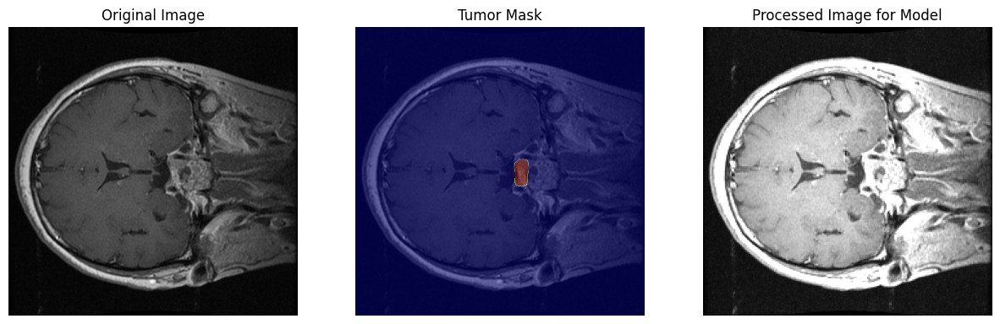

The prediction is correct!


In [14]:
import numpy as np
import tensorflow as tf
import h5py
from tensorflow.keras.models import load_model
import matplotlib.pyplot as plt

def load_and_preprocess_image(file_path):
    with h5py.File(file_path, 'r') as file:
        image = np.array(file['cjdata/image'][()])
        try:
            mask = np.array(file['cjdata/tumorMask'][()])
        except KeyError:
            mask = None  # In case there is no segmentation data
    image_normalized = image / 255.0  # Normalize to [0, 1]
    image_rgb = np.stack((image_normalized,)*3, axis=-1)  # Convert grayscale to RGB
    image_resized = tf.image.resize(image_rgb, (224, 224))  # Resize for the model
    return image_resized, image, mask

def predict_image(model, file_path):
    processed_image, original_image, mask = load_and_preprocess_image(file_path)
    processed_image = np.expand_dims(processed_image, axis=0)  # Add batch dimension
    prediction = model.predict(processed_image)
    predicted_class = np.argmax(prediction, axis=1)
    return predicted_class, original_image, processed_image, mask

def get_true_label(file_path):
    with h5py.File(file_path, 'r') as file:
        label = int(file['cjdata/label'][0])
    return label

# Load the model
model = load_model('/kaggle/working/my_model.h5')

# Provide the path to your image
file_path = '/kaggle/input/brain-tumor/brainTumorDataPublic_1766 2/brainTumorDataPublic_1766/1116.mat'

# Get prediction and images
predicted_class, original_image, processed_image, mask = predict_image(model, file_path)
true_label = get_true_label(file_path)  # Get the true label for verification

# Adjusting the predicted class and true label index based on your label encoding
predicted_class = predicted_class[0] + 1
print(f"Predicted Class: {predicted_class}, True Label: {true_label}")

# Display images
fig, axes = plt.subplots(1, 3, figsize=(15, 5))
axes[0].imshow(original_image, cmap='gray')
axes[0].set_title('Original Image')
axes[0].axis('off')

if mask is not None:
    axes[1].imshow(original_image, cmap='gray')
    axes[1].imshow(mask, alpha=0.5, cmap='jet')  # Overlay mask with transparency
    axes[1].set_title('Tumor Mask')
    axes[1].axis('off')
else:
    axes[1].text(0.5, 0.5, 'No mask available', horizontalalignment='center', verticalalignment='center')
    axes[1].set_title('Tumor Mask')
    axes[1].axis('off')

axes[2].imshow(processed_image[0])
axes[2].set_title('Processed Image for Model')
axes[2].axis('off')

plt.show()

# Verify the prediction
if predicted_class == true_label:
    print("The prediction is correct!")
else:
    print("The prediction is incorrect.")